https://www.kaggle.com/ekrembayar/store-sales-ts-forecasting-a-comprehensive-guide

In [1]:
import os
import gc

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import seaborn as sns
import statsmodels.api as sm

In [2]:
train = pd.read_csv('./data/train.csv', parse_dates=['date'])
test = pd.read_csv('./data/test.csv', parse_dates=['date'])
stores = pd.read_csv('./data/stores.csv')
transactions = pd.read_csv('./data/transactions.csv', parse_dates=['date'])
oil = pd.read_csv('./data/oil.csv', parse_dates=['date'])
holidays = pd.read_csv('./data/holidays_events.csv', parse_dates=['date'])

In [3]:
train = train[~((train.store_nbr == 52) & (train.date < "2017-04-20"))]
train = train[~((train.store_nbr == 22) & (train.date < "2015-10-09"))]
train = train[~((train.store_nbr == 42) & (train.date < "2015-08-21"))]
train = train[~((train.store_nbr == 21) & (train.date < "2015-07-24"))]
train = train[~((train.store_nbr == 29) & (train.date < "2015-03-20"))]
train = train[~((train.store_nbr == 20) & (train.date < "2015-02-13"))]
train = train[~((train.store_nbr == 53) & (train.date < "2014-05-29"))]
train = train[~((train.store_nbr == 36) & (train.date < "2013-05-09"))]

In [4]:
train.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0


In [5]:
stores.head()

,store_nbr,city,state,type,cluster
0,1,Quito,Pichincha,D,13
1,2,Quito,Pichincha,D,13
2,3,Quito,Pichincha,D,8
3,4,Quito,Pichincha,D,9
4,5,Santo Domingo,Santo Domingo de los Tsachilas,D,4


In [6]:
transactions.head()

,date,store_nbr,transactions
0,2013-01-01,25,770
1,2013-01-02,1,2111
2,2013-01-02,2,2358
3,2013-01-02,3,3487
4,2013-01-02,4,1922


In [7]:
oil.head()

,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20


In [8]:
holidays.head()

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [9]:
transactions_sales = pd.merge(
    train.groupby(['date', 'store_nbr']).sales.sum().reset_index(),
    transactions,
    how='left',
    on=['date', 'store_nbr'],
).fillna(0)
transactions_sales[['sales', 'transactions']].corr('spearman')

,sales,transactions
sales,1.000000,0.817698
transactions,0.817698,1.000000


In [10]:
px.line(
    transactions.sort_values(['store_nbr', 'date']),
    x='date',
    y='transactions',
    color='store_nbr',
    title='Transactions',
)

In [11]:
temp = transactions.copy()
temp['year'] = temp.date.dt.year
temp['month'] = temp.date.dt.month
px.box(temp, x='year', y='transactions', color='month', title='Transactions')

In [12]:
temp = transactions.set_index('date').resample('M').transactions.mean().reset_index()
temp['year'] = temp.date.dt.year

px.line(temp, x='date', y='transactions', color='year', title='Montly average transactions')

In [13]:
px.scatter(
    transactions_sales,
    x='transactions', 
    y='sales', 
    trendline='ols',
    trendline_color_override='red',
)

In [14]:
temp = transactions.copy()
temp['year'] = temp.date.dt.year
temp['day_of_week'] = temp.date.dt.day_of_week + 1

temp = temp.groupby(['year', 'day_of_week']).transactions.mean().reset_index()
px.line(temp, x='day_of_week', y='transactions', color='year', title='Transactions')

In [15]:
oil_resampled = oil.set_index('date').dcoilwtico.resample('D').sum().reset_index()
oil_resampled.loc[oil_resampled.dcoilwtico == 0, 'dcoilwtico'] = np.nan
oil_resampled['dcoilwtico_interpolated'] = oil_resampled.dcoilwtico.interpolate()

oil_resampled.head()

,date,dcoilwtico,dcoilwtico_interpolated
0,2013-01-01,NaN,NaN
1,2013-01-02,93.14,93.140000
2,2013-01-03,92.97,92.970000
3,2013-01-04,93.12,93.120000
4,2013-01-05,NaN,93.146667


In [16]:
temp = oil_resampled.melt(id_vars=['date'], var_name='Legend')
px.line(
    temp.sort_values(['Legend', 'date'], ascending=[False, True]),
    x='date',
    y='value',
    color='Legend',
    title='Daily oil price',
)

In [17]:
temp = pd.merge(
    transactions_sales,
    oil_resampled,
    how='left',
)
temp[['sales', 'transactions', 'dcoilwtico_interpolated']].corr('spearman')

,sales,transactions,dcoilwtico_interpolated
sales,1.000000,0.817698,-0.263742
transactions,0.817698,1.000000,0.041581
dcoilwtico_interpolated,-0.263742,0.041581,1.000000


Text(0.5, 1.0, 'Daily oil price & sales')

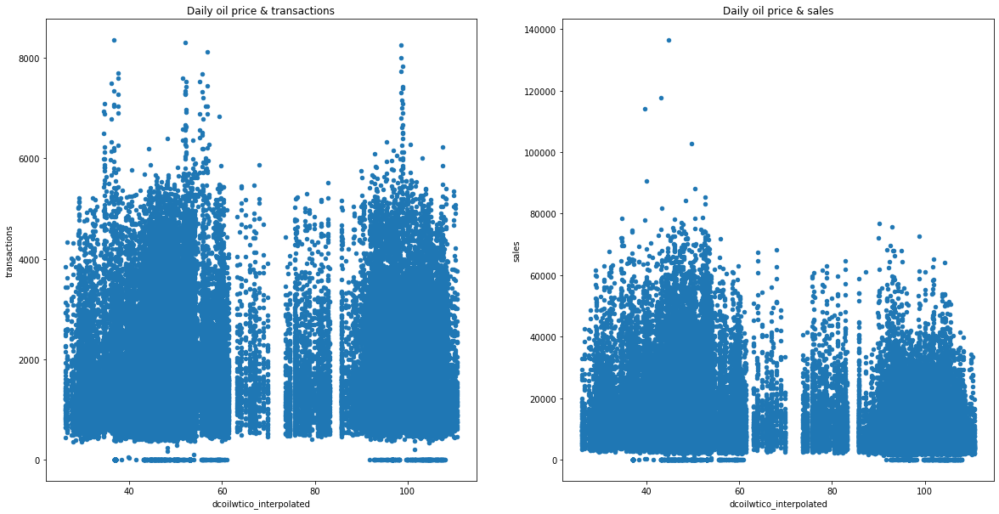

In [18]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
temp.plot.scatter(x='dcoilwtico_interpolated', y='transactions', ax=ax1)
temp.plot.scatter(x='dcoilwtico_interpolated', y='sales', ax=ax2)
ax1.set_title('Daily oil price & transactions')
ax2.set_title('Daily oil price & sales')

In [19]:
temp = pd.merge(
    train.groupby(['date', 'family']).sales.sum().reset_index(),
    oil_resampled[['date', 'dcoilwtico_interpolated']],
    how='left',
)
corr = temp.groupby(['family']).corr('spearman').reset_index()
corr = corr[corr.level_1 == 'dcoilwtico_interpolated'][['family', 'sales']]
corr = corr.sort_values('sales')

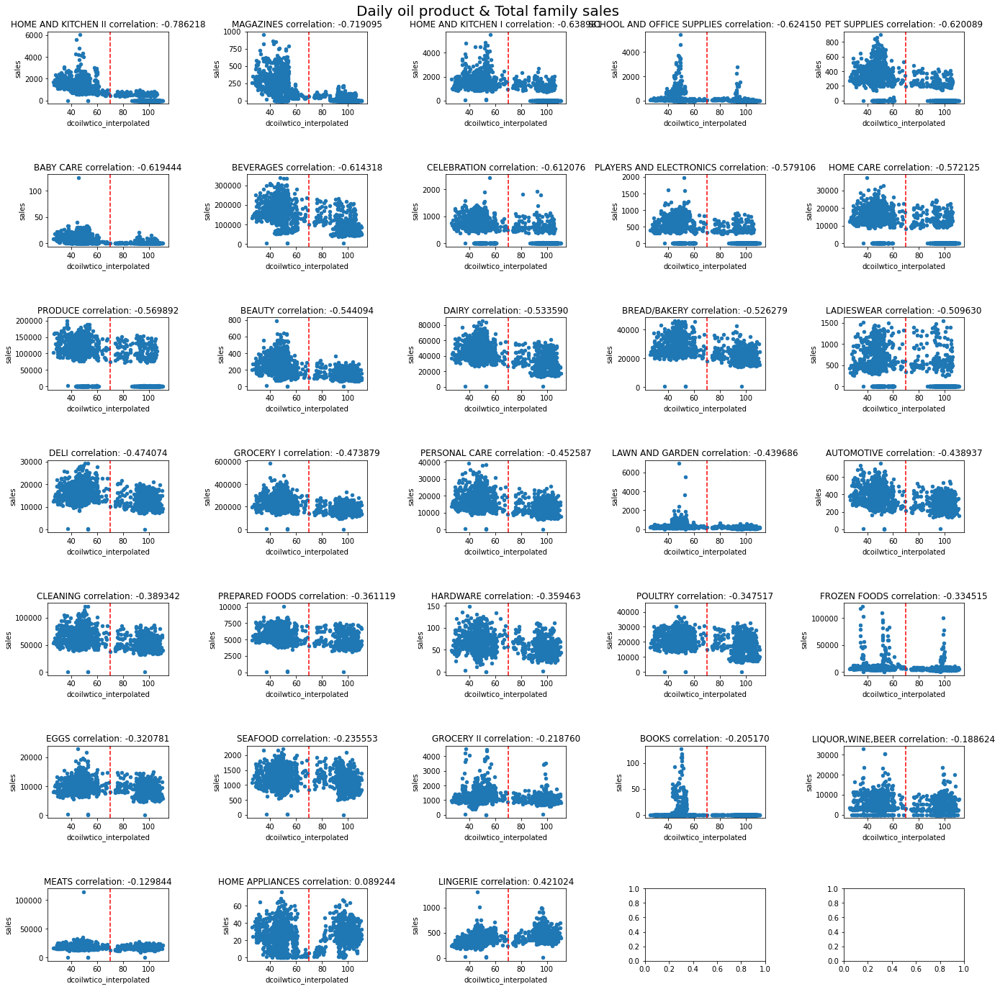

In [20]:
fig, axes = plt.subplots(7, 5, figsize=(20, 20))
for idx, family in enumerate(corr.family):
    ax = axes[idx // 5, idx % 5]
    temp[temp.family == family].plot.scatter(
        x='dcoilwtico_interpolated',
        y='sales',
        ax=ax,
    )
    c = corr[corr.family == family].sales.iloc[0]
    ax.set_title(f'{family} correlation: {c:2f}', fontsize=12)
    ax.axvline(x=70, color='r', linestyle='--')

plt.tight_layout(pad=5)
plt.suptitle('Daily oil product & Total family sales', fontsize=20)

plt.show()

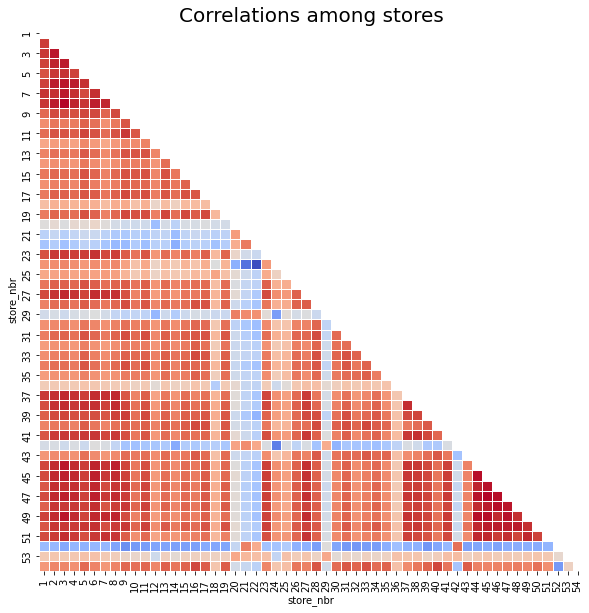

In [21]:
temp = train[['store_nbr', 'sales']].copy()
temp['ind'] = 1
temp['ind'] = temp.groupby(['store_nbr']).ind.cumsum().values
temp = pd.pivot(temp, index='ind', columns='store_nbr', values='sales')
mask = np.triu(temp.corr('spearman'))

plt.figure(figsize=(10, 10))
sns.heatmap(
    temp.corr('spearman'),
    fmt='.1f',
    cmap='coolwarm',
    square=True,
    mask=mask,
    linewidth=1,
    cbar=False,
)
plt.title('Correlations among stores', fontsize=20)
plt.show()

In [22]:
temp = train.set_index('date').groupby('store_nbr').resample('D').sales.sum().reset_index()
px.line(temp, x='date', y='sales', color='store_nbr', title='Daily total sales of the stores')

In [23]:
temp = train.groupby(['store_nbr', 'family']).sales.sum().reset_index().sort_values(['family', 'store_nbr'])
temp = temp[temp.sales == 0]
temp

,store_nbr,family,sales
1,1,BABY CARE,0.0
397,13,BABY CARE,0.0
727,23,BABY CARE,0.0
1420,44,BABY CARE,0.0
1453,45,BABY CARE,0.0
1486,46,BABY CARE,0.0
1519,47,BABY CARE,0.0
1552,48,BABY CARE,0.0
1585,49,BABY CARE,0.0
1618,50,BABY CARE,0.0


In [24]:
print(train.shape)
outer_join = train.merge(temp.drop('sales', axis=1), how='outer', indicator=True)
train = outer_join[~(outer_join._merge == 'both')].drop('_merge', axis = 1)
del outer_join
gc.collect()
train.shape

(2780316, 6)


(2698648, 6)

In [25]:
zero_prediction = []
for i in range(0, len(temp)):
    zero_prediction.append(
        pd.DataFrame({
            "date": pd.date_range("2017-08-16", "2017-08-31").tolist(),
            "store_nbr": temp.store_nbr.iloc[i],
            "family": temp.family.iloc[i],
            "sales": 0,
        })
    )
zero_prediction = pd.concat(zero_prediction)
del temp
gc.collect()
zero_prediction

,date,store_nbr,family,sales
0,2017-08-16,1,BABY CARE,0
1,2017-08-17,1,BABY CARE,0
2,2017-08-18,1,BABY CARE,0
3,2017-08-19,1,BABY CARE,0
4,2017-08-20,1,BABY CARE,0
...,...,...,...,...
11,2017-08-27,54,LAWN AND GARDEN,0
12,2017-08-28,54,LAWN AND GARDEN,0
13,2017-08-29,54,LAWN AND GARDEN,0
14,2017-08-30,54,LAWN AND GARDEN,0


In [26]:
temp = train.set_index("date").groupby("family").resample("D").sales.sum().reset_index()
px.line(temp, x="date", y="sales", color="family", title="Daily total sales of the family")

In [27]:
temp = train.groupby("family").sales.mean().sort_values(ascending=False).reset_index()
px.bar(temp, y="family", x="sales", color="family", title="Which product family preferred more?")

In [28]:
train.corr("spearman").sales.loc["onpromotion"]

0.5304220325839817

In [29]:
d = pd.merge(train, stores)
d["store_nbr"] = d["store_nbr"].astype("int8")
d["year"] = d.date.dt.year
px.line(d.groupby(["city", "year"]).sales.mean().reset_index(), x = "year", y = "sales", color = "city")